# Multi-Band Auto-Encoder
### This Network should learn to compress the information from multiple 2400 channel spectrograms of different window lengths into a low dimensional latent space.

### - This latent space can then be used to train a `Text -> Feature -> Vocoder` setup in place of typical Mel-Spectrograms.

### - The latent space should contain multiple windows worth of information, and potentially encode the types of noise occuring in the frame.

---

- ### Updated to add iso226 volume scaling for features. (noticed far too much model focus on 11Khz+ channels)

---

# -1 - Install ISO226

In [1]:
try:
    import iso226
except:
    !git clone https://github.com/jacobbaylesssmc/iso226
    !cd iso226; python3 -m pip install ./

# 0 - Import Dependancies/Modules


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import os
os.environ["LRU_CACHE_CAPACITY"] = "3"
import random

from CookieTTS.utils.dataset.utils import load_wav_to_torch, load_filepaths_and_text

---

# 1 - Load Dataset

In [3]:
import os
import random
from glob import glob
from CookieTTS.utils.dataset.utils import load_wav_to_torch
from CookieTTS.utils.audio.stft import STFT
from CookieTTS.utils.audio.audio_processing import window_sumsquare, dynamic_range_compression, dynamic_range_decompression

class MultiResSpect(nn.Module):
    def __init__(self, win_lens, fil_len, hop_len):
        super(MultiResSpect, self).__init__()
        self.stfts = nn.ModuleList()
        for win_len in win_lens:
            stft = STFT(filter_length=fil_len,
                           hop_length=hop_len,
                           win_length=win_len,)
            self.stfts.append(stft)
    
    def get_mel(self, audio):# [T]
        """Take audio and convert to multi-res spectrogram"""
        melspec = []
        for stft in self.stfts:
            spect = stft.transform(audio.unsqueeze(0), return_phase=False)[0].squeeze(0)# -> [n_mel, dec_T]
            #print(spect.shape)
            melspec.append(spect)
        return torch.cat(melspec, dim=0)# [[n_mel, dec_T], ...] -> [n_stft*n_mel, dec_T]

class AudioDataset(torch.utils.data.Dataset):
    def __init__(self, model_config, directory, wildcard_filter = "*.wav"):
        print("Finding Audio Files...")
        self.audio_files = glob( os.path.join(directory, "**", wildcard_filter), recursive=True)
        print("Done")
        
        random.seed(1234)
        random.shuffle(self.audio_files)
        self.len = len(self.audio_files)
        
        self.n_group = model_config['n_group']
        self.max_len_s = model_config['max_len_s']
        self.win_lens = model_config['window_lengths']
        self.hop_len = model_config['hop_length']
        self.fil_len = model_config['filter_length']
        #self.MRS = MultiResSpect(self.win_lens, self.fil_len, self.hop_len)
        
        self.directory = directory
        self.wildcard_filter = wildcard_filter
    
    def __getitem__(self, index):
        audio_path = self.audio_files[index]
        audio, sampling_rate, max_mag = load_wav_to_torch(audio_path) # load mono audio from file
        audio = audio / max_mag # normalize to range [-1, 1]
        
        audio = audio[:int(self.max_len_s*sampling_rate)]
        audio = audio[:audio.shape[0]//self.n_group * self.n_group]
        
        #spect = self.MRS.get_mel(audio)
        #spect = dynamic_range_compression(spect)
        spect = None
        
        spect_length = 1#spect.shape[1]
        audio_sq = audio.view(-1, self.n_group).transpose(0, 1)# [n_group, T//n_group]
        return (audio_sq, spect_length, spect)
    
    def __len__(self):
        return self.len

In [4]:
class MelCollate():
    def __init__(self):
        pass
    
    def __call__(self, batch):
        B = len(batch)
        lengths = [x[0].shape[1] for x in batch]
        n_mel = batch[0][0].shape[0]
        max_length = max(*lengths)
        b_spect = [x[0] for x in batch]
        b_spect = torch.cat(b_spect, dim=1).unsqueeze(0)# [1, n_stft*n_mel, sum(dec_T)]
        
        #for i in range(B):
        #    spect = batch[i][0]
        #    b_spect[i, :, :spect.shape[1]] = spect
        
        spect_lengths = torch.tensor([sum(lengths),])
        model_inputs = (b_spect, spect_lengths)
        return model_inputs

---

# 2 - Init Model

In [5]:
class TemporalBlock(nn.Module):
    def __init__(self, input_dim, output_dim, n_layers, n_dim, kernel_w, bias=True, act_func=nn.LeakyReLU(negative_slope=0.1, inplace=True), dropout=0.0, res=False):
        super(TemporalBlock, self).__init__()
        self.layers = nn.ModuleList()
        for i in range(n_layers):
            in_dim = input_dim if i == 0 else n_dim
            out_dim = output_dim if i+1 == n_layers else n_dim
            pad = (kernel_w - 1)//2
            conv = nn.Conv1d(in_dim, out_dim, kernel_w, padding=pad, bias=bias)
            self.layers.append(conv)
        self.act_func = act_func
        self.dropout = dropout
        self.res = res
        if self.res:
            assert input_dim == output_dim, 'residual connection requires input_dim and output_dim to match.'
    
    def forward(self, x): # [B, in_dim, T]
        skip = x
        
        for i, layer in enumerate(self.layers):
            is_last_layer = bool( i+1 == len(self.layers) )
            x = layer(x)
            if not is_last_layer:
                x = self.act_func(x)
            if self.dropout > 0.0 and self.training:
                x = F.dropout(x, p=self.dropout, training=self.training, inplace=True)
        if self.res:
            x += skip
        return x # [B, out_dim, T]


class Coder(nn.Module):
    def __init__(self, model_config, input_dim=None, output_dim=None, output_batchnorm=False):
        super(Coder, self).__init__()
        self.input_dim = ((model_config['filter_length']//2) + 1) * len(model_config['window_lengths']) if input_dim is None else input_dim
        self.output_dim = model_config['latent_dim'] if output_dim is None else output_dim
        self.device = "cuda"
        
        self.temporalblocks = nn.ModuleList()
        for i in range(model_config['n_blocks']):
            b_first_block = bool(i == 0)
            b_last_block = bool(i+1 == model_config['n_blocks'])
            in_dim  = self.input_dim if b_first_block else model_config['n_dim']
            out_dim = self.output_dim if b_last_block else model_config['n_dim']
            res = True if (model_config['residual_connections'] and in_dim == out_dim) else False
            n_layers = model_config['bottleneck_n_layers'] if b_first_block or b_last_block else model_config['n_layers']
            temp_block = TemporalBlock(in_dim, out_dim, n_layers, model_config['n_dim'],
                                       model_config['kernel_width'], bias = model_config['bias'],
                                       dropout = model_config['dropout'], res=res)
            self.temporalblocks.append(temp_block)
        
        if output_batchnorm:
            self.bn_out = nn.BatchNorm1d(self.output_dim, momentum=0.05)
    
    def forward(self, spect):
        assert spect.shape[1] == self.input_dim, f'input Tensor is wrong shape ({spect.shape}). Expected {self.input_dim} channels.'
        spect = spect.to(self.device)
        
        for block in self.temporalblocks:
            spect = block(spect)
        
        spect = spect.clone()
        
        if hasattr(self, 'bn_out'):
            spect = self.bn_out(spect)
        return spect


class AutoEncoder(nn.Module):
    def __init__(self, model_config):
        super(AutoEncoder, self).__init__()
        self.in_out_dim = model_config['n_group']
        self.latent_dim = model_config['latent_dim']
        
        self.encoder = Coder(model_config, self.in_out_dim, self.latent_dim, output_batchnorm=True)
        self.decoder = Coder(model_config, self.latent_dim, self.in_out_dim)
    
    def get_specs(self, audio):
        spects = []
        for stft in self.stfts:
            spect = stft.transform(audio.unsqueeze(0), return_phase=False)[0].squeeze(0)# -> [n_mel, dec_T]
            spects.append(spect)
        spect = torch.cat(spects, dim=0)# [[n_mel, dec_T], ...] -> [n_stft*n_mel, T//hop_len]
        spect = dynamic_range_compression(spect)# change to clamped log-scale magnitudes
        return spect.unsqueeze(0)# -> [1, n_stft*n_mel, T//hop_len]
    
    def encode_audiopath(self, audio_path):
        audio, sampling_rate, max_mag = load_wav_to_torch(audio_path) # load mono audio from file
        audio = audio / max_mag # normalize to range [-1, 1]
        return self.encode_audio(audio)
    
    def encode_audio(self, audio):
        """Encoder [T] Tensor into Z learned latent representation."""
        spect = self.get_specs(audio)# -> [B, n_stfts*n_fft, T]
        z = self.encoder(spect)# -> [B, z_dim, T]
        return z
    
    def decoder_latent(self, z):
        B, C, T = z.shape
        return self.decoder(z).view(B, -1)
    
    def forward(self, inputs):
        spect, spect_lengths = inputs
        
        z = self.encoder(spect)
        
        rec_spect = self.decoder(z)
        
        return rec_spect.clone()

In [6]:
import torch
import numpy as np
import iso226
import math
import random
from CookieTTS.utils.model.utils import get_mask_from_lengths

# https://www.desmos.com/calculator/4nac7kvt7p
# Squash smaller values together so that mse loss is lower on quieter parts of the spectrogram.
def vol_rescale_loss(mel, power=0.5, min=-11.55):
    mel = mel + (power/(-min*2))*(mel**2)
    return mel


class LossFunction(nn.Module):
    def __init__(self, model_config):
        super(LossFunction, self).__init__()
        self.win_lens = model_config['window_lengths']
        self.hop_len = model_config['hop_length']
        self.fil_len = model_config['filter_length']
        self.MRS = MultiResSpect(self.win_lens, self.fil_len, self.hop_len).cuda()
        
        iso226_spl_from_freq = iso226.iso226_spl_itpl(L_N=60, hfe=True)# get InterpolatedUnivariateSpline for Perc Sound Pressure Level at Difference Frequencies with 60DB ref.
        self.freq_weights = torch.tensor([(2**(60./10))/(2**(iso226_spl_from_freq(freq)/10)) for freq in np.linspace(0, model_config['sampling_rate']//2, (model_config['filter_length']//2)+1)])
        self.freq_weights = self.freq_weights.cuda().repeat(len(model_config['window_lengths']))[None, :, None]# [B, n_mel, T]
        
        self.loud_loss_priority_str = model_config['loud_loss_priority']
    
    def forward(self, y, x):
        gt_audio, lengths = x
        audio_offset = int(random.uniform(0, self.hop_len))
        gt_audio = gt_audio[0].cuda().transpose(0, 1).reshape(-1)
        gt_audio = gt_audio[audio_offset:]
        gt_spect = self.MRS.get_mel(gt_audio)
        gt_spect = dynamic_range_compression(gt_spect)
        pred_audio = y
        pred_audio = pred_audio[0].transpose(0, 1).reshape(-1)
        pred_audio = pred_audio[audio_offset:]
        pred_spect = self.MRS.get_mel(pred_audio)
        pred_spect = dynamic_range_compression(pred_spect)
        
        #mask = get_mask_from_lengths(lengths.cuda())
        #mask = mask.expand(gt_spect.size(1), mask.size(0), mask.size(1))
        #mask = mask.permute(1, 0, 2)
        #gt_spect.detach()[~mask] = 0.0
        #pred_spect.detach()[~mask] = 0.0
        
        if self.loud_loss_priority_str > 0:
            pred_spect = vol_rescale_loss(pred_spect, power=self.loud_loss_priority_str)
            gt_spect = vol_rescale_loss(gt_spect, power=self.loud_loss_priority_str)
        
        MAE = F.mse_loss(pred_spect, gt_spect, reduction='none')
        MAE = MAE * self.freq_weights# [B, n_mel, T] * [1, n_mel, 1]
        #MAE = torch.masked_select(MAE, mask)# [B, n_mel, T] -> [n_mel*sum(n_frames)]
        
        return MAE.mean(), gt_spect, pred_spect

# 2.9 - Plot Data

In [7]:
import matplotlib
%matplotlib inline
import matplotlib.pylab as plt
import IPython.display as ipd

def plot_data(data, title=None, figsize=(20, 7.5), range_=[-11.6, 2.0]):
    """
    data: list([height, width], [height, width], ...)
    """
    #for i in range(len(data)):
    #    data[i][0,0] = range_[0]
    #    data[i][0,1] = range_[1]
    fig, axes = plt.subplots(1, len(data), figsize=figsize)
    for i in range(len(data)):
        if title:
            axes[i].set_title(title[i])
        axes[i].imshow(data[i], aspect='auto', origin='bottom', 
                       interpolation='none')
    plt.show()
    %matplotlib inline

---

# 3 - Train and Eval

Config

In [28]:
model_config = {
    "audio_directory": "/media/cookie/Samsung 860 QVO/ClipperDatasetV2",#r"H:\ClipperDatasetV2\SlicedDialogue",
    "wildcard_filter": "*.wav",
    "batch_size": 16,
    'max_len_s': 6.0,
    "learning_rate": 5e-5,
    "latent_dim": 256,
    "loud_loss_priority": 0.0,# squash smaller values so model will prioritise louder parts of the spectrogram. # 0.0 = Off, 1.0 = Nearly parts have 0.0 loss.
    "n_group": 600,
    "sampling_rate": 48000,
    "window_lengths": [600, 1200, 1800, 2400],
    "hop_length": 600,
    "filter_length": 2400,
    "n_blocks": 12,#3,
    "n_layers": 4,
    "bottleneck_n_layers": 1,
    "n_dim": 512,
    "kernel_width": 1,
    "residual_connections": True,
    "bias": True,
    "dropout": 0.00,
}

---

The rest

In [9]:
from torch.utils.data import DataLoader

n_epochs = 200

dataset = AudioDataset(model_config, model_config['audio_directory'], model_config['wildcard_filter'])

Finding Audio Files...
Done


In [23]:
# Initialize Training
collate_fn = MelCollate()
train_loader = DataLoader(dataset, num_workers=2, shuffle=True,
                              batch_size=model_config['batch_size'],
                              pin_memory=False, drop_last=True,
                              collate_fn=collate_fn)

In [22]:
criterion = LossFunction(model_config)

In [29]:
# Initialize/Reset Model
model = AutoEncoder(model_config).cuda()

if False:
    checkpoint_path = "AudioAutoEncoder_50000.pt"
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
    model.load_state_dict(checkpoint_dict['model'])

In [30]:
optimizer = torch.optim.Adam(model.parameters(), lr=model_config['learning_rate'])

iteration = 0
avg_training_loss = 2.0

Epoch: 0

[Iter 0     ] [Training Loss 13.961 Avg 2.598]

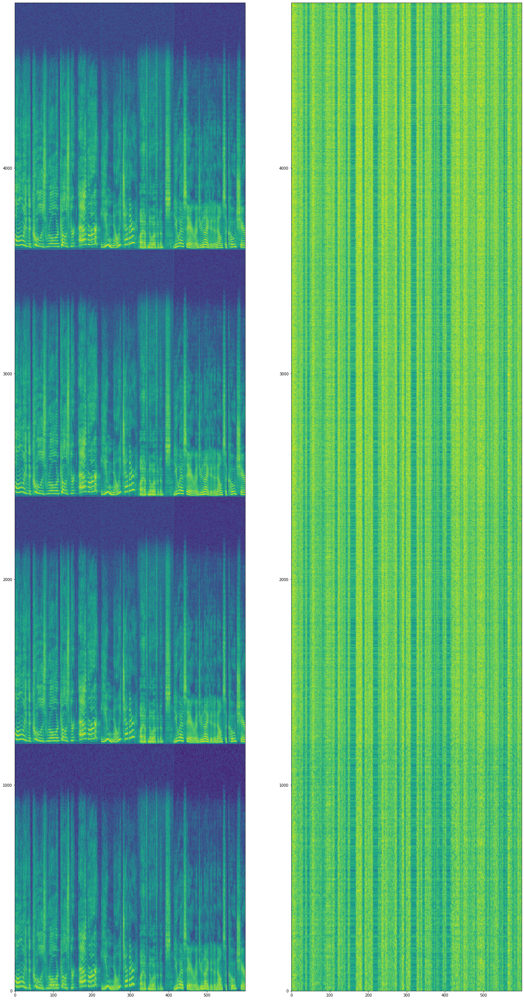

........................
[Iter 25    ] [Training Loss 8.438 Avg 7.939]........................
[Iter 50    ] [Training Loss 6.125 Avg 7.174]........................
[Iter 75    ] [Training Loss 5.886 Avg 5.983]........................
[Iter 100   ] [Training Loss 4.117 Avg 5.192]

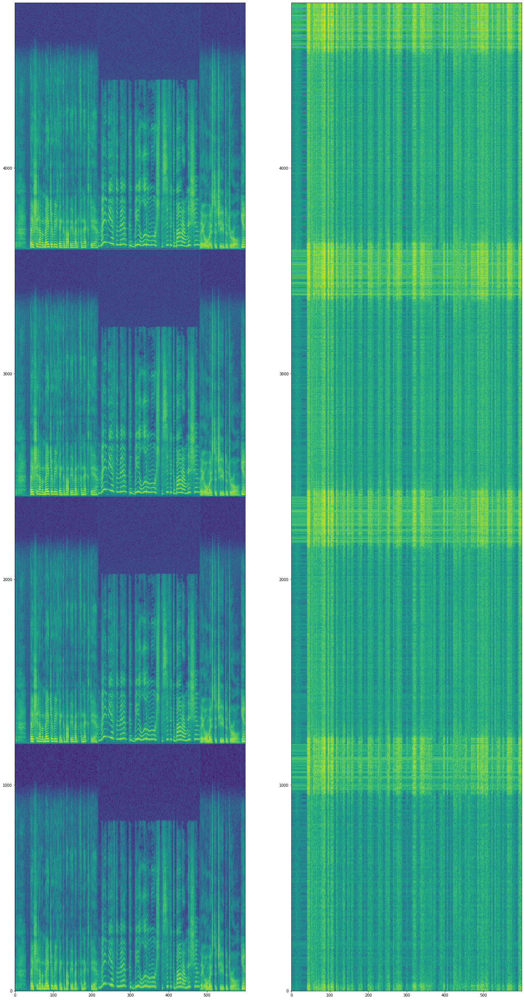

........................
[Iter 125   ] [Training Loss 4.368 Avg 4.553]........................
[Iter 150   ] [Training Loss 3.878 Avg 4.104]........................
[Iter 175   ] [Training Loss 3.683 Avg 3.800]........................
[Iter 200   ] [Training Loss 3.436 Avg 3.475]........................
[Iter 225   ] [Training Loss 3.703 Avg 3.238]........................
[Iter 250   ] [Training Loss 2.966 Avg 3.039]........................
[Iter 275   ] [Training Loss 2.384 Avg 2.941]........................
[Iter 300   ] [Training Loss 2.458 Avg 2.744]........................
[Iter 325   ] [Training Loss 2.773 Avg 2.767]........................
[Iter 350   ] [Training Loss 2.648 Avg 2.776]........................
[Iter 375   ] [Training Loss 2.890 Avg 2.743]........................
[Iter 400   ] [Training Loss 2.218 Avg 2.750]........................
[Iter 425   ] [Training Loss 2.361 Avg 2.788]........................
[Iter 450   ] [Training Loss 2.280 Avg 2.622]....................

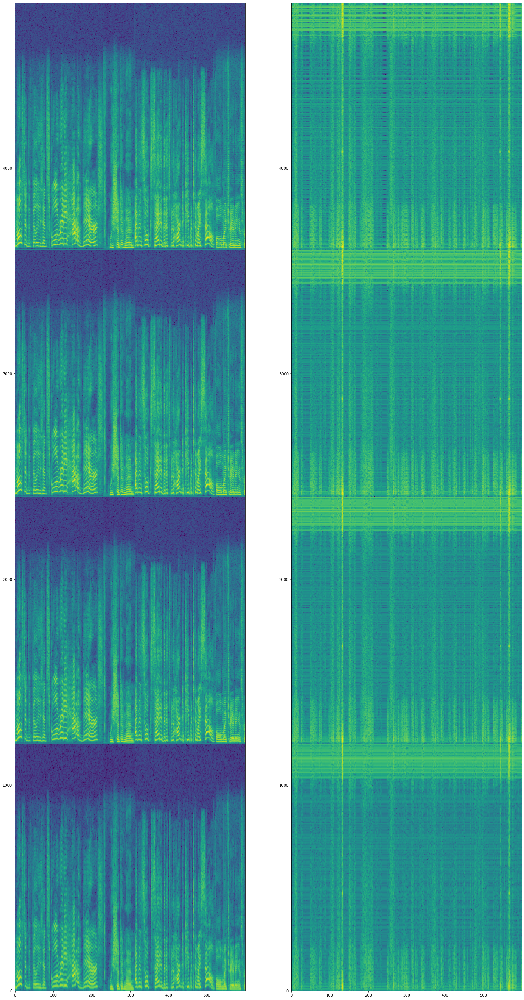

........................
[Iter 1025  ] [Training Loss 1.939 Avg 2.098]........................
[Iter 1050  ] [Training Loss 2.126 Avg 2.112]........................
[Iter 1075  ] [Training Loss 2.396 Avg 2.123]........................
[Iter 1100  ] [Training Loss 1.886 Avg 2.111]........................
[Iter 1125  ] [Training Loss 2.624 Avg 2.096]........................
[Iter 1150  ] [Training Loss 2.082 Avg 2.083]........................
[Iter 1175  ] [Training Loss 2.270 Avg 2.111]........................
[Iter 1200  ] [Training Loss 1.758 Avg 2.044]........................
[Iter 1225  ] [Training Loss 1.937 Avg 2.059]........................
[Iter 1250  ] [Training Loss 2.738 Avg 2.201]........................
[Iter 1275  ] [Training Loss 1.983 Avg 2.146]........................
[Iter 1300  ] [Training Loss 2.510 Avg 2.233]........................
[Iter 1325  ] [Training Loss 2.119 Avg 2.136]........................
[Iter 1350  ] [Training Loss 2.029 Avg 2.093]....................

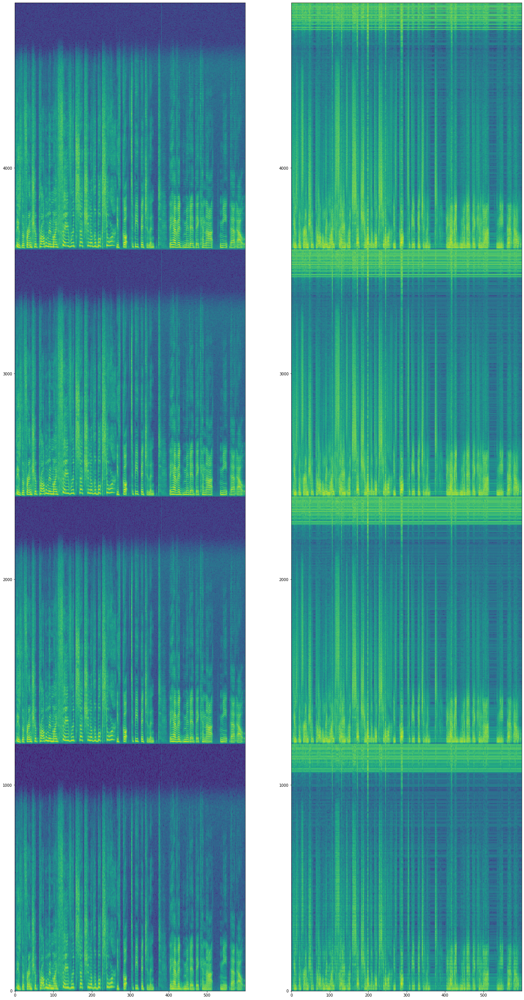

........................
[Iter 25025 ] [Training Loss 1.060 Avg 1.011]........................
[Iter 25050 ] [Training Loss 0.890 Avg 1.034]........................
[Iter 25075 ] [Training Loss 1.041 Avg 1.064]........................
[Iter 25100 ] [Training Loss 1.086 Avg 1.084]........................
[Iter 25125 ] [Training Loss 1.068 Avg 1.063]........................
[Iter 25150 ] [Training Loss 0.995 Avg 1.058]........................
[Iter 25175 ] [Training Loss 1.058 Avg 1.023]........................
[Iter 25200 ] [Training Loss 1.073 Avg 1.052]........................
[Iter 25225 ] [Training Loss 1.055 Avg 1.021]........................
[Iter 25250 ] [Training Loss 0.994 Avg 1.015]........................
[Iter 25275 ] [Training Loss 1.215 Avg 1.065]........................
[Iter 25300 ] [Training Loss 0.971 Avg 1.033]........................
[Iter 25325 ] [Training Loss 1.070 Avg 1.030]........................
[Iter 25350 ] [Training Loss 1.098 Avg 1.068]....................

KeyboardInterrupt: 

In [31]:
model.train()

for epoch in range(n_epochs):
    print(f"Epoch: {epoch}")
    for i, batch in enumerate(train_loader):
        learning_rate = 1e-4
        if iteration > 100000:
            learning_rate = 0.5e-4
        if iteration > 150000:
            learning_rate = 0.5e-4
        if iteration > 200000:
            learning_rate = 0.25e-4
        
        for param_group in optimizer.param_groups:
            param_group['lr'] = learning_rate
        
        model.zero_grad()
        outputs = model(batch)
        loss, gt_spect, pred_spect = criterion(outputs, batch)
        reduced_loss = loss.item()
        loss.backward()
        optimizer.step()
        
        avg_training_loss = avg_training_loss*0.95 + reduced_loss*(1-0.95)
        if iteration%25 == 0:
            print(f"\n[Iter {iteration:<6}] [Training Loss {reduced_loss:5.3f} Avg {avg_training_loss:5.3f}]", end='')
        else:
            print(".", end='')
        if True and (iteration%25000 == 0 or iteration==100 or iteration==1000):
            plot_data([gt_spect[:,:600].float().cpu().detach().numpy() for x in batch[0:1]]+\
                      [pred_spect[:,:600].float().cpu().detach().numpy()],
                      figsize=(24, 48))
        if iteration%50000==0:
            filepath = "/media/cookie/Samsung PM961/TwiBot/CookiePPPTTS/CookieTTS/scripts/AudioAutoEncoder"+f"_{iteration}.pt"
            saving_dict = {
                'model': model.state_dict(),
                'iteration': iteration,
                'optimizer': optimizer.state_dict(),
                'learning_rate': learning_rate}
            torch.save(saving_dict, filepath)
        iteration+=1

In [ ]:
# save model
#filepath = r"G:\TwiBot\CookiePPPTTS\CookieTTS\scripts\MelAutoEncoder"+f"_{iteration}.pt"
filepath = "/media/cookie/Samsung PM961/TwiBot/CookiePPPTTS/CookieTTS/scripts/MelAutoEncoder"+f"_{iteration}.pt"

print(f"Saving checkpoint to '{filepath}'")
saving_dict = {
    'model': model.state_dict(),
    'iteration': iteration,
    'optimizer': optimizer.state_dict(),
    'learning_rate': learning_rate,
    }
torch.save(saving_dict, filepath)
print("Done")

---

# 4 - Convert Dataset to new Latent features.

#### `.wav` -> `.npy`

In [ ]:
# load model
model = AutoEncoder(model_config).cuda()

checkpoint_path = "MelAutoEncoder_111320_AEF4.pt"
checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint_dict['model'])
_ = model.eval()

In [16]:
hop_len = 600
# update as needed!

model.stfts = []
for win_len in model_config['window_lengths']:
    stft = STFT(filter_length=model_config['filter_length'],
                hop_length=hop_len, win_length=win_len,)
    model.stfts.append(stft)

In [17]:
from glob import glob
directory = "/media/cookie/Samsung 860 QVO/ClipperDatasetV2"

with torch.no_grad():
    audiopaths = glob( os.path.join(directory, "**", "*.wav"), recursive=True)
    len_audiopaths = len(audiopaths)
    for i, audiopath in enumerate(audiopaths):
        latent_z = model.encode_audiopath(audiopath).squeeze(0)
        print(f'{i:6}/{len_audiopaths:<6} {latent_z.shape}', end='\r')
        new_save_path = audiopath.replace('.wav','.npy')
        #print(torch.from_numpy(np.load(new_save_path)).shape)
        np.save(new_save_path, latent_z.data.squeeze().float().cpu().numpy())
    print("\nDone!")

 91723/91724  torch.Size([160, 88]))])
Done!
